In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from pandas.plotting import scatter_matrix

In [2]:
import plotly as py
import plotly.graph_objs as go
from plotly.offline import iplot, init_notebook_mode
# Using plotly + cufflinks in offline mode
init_notebook_mode(connected=True)

In [3]:
from urllib.request import urlopen
import json
import plotly.express as px

In [4]:
data_1 = pd.read_pickle('data_new_0_1800.pickle')

In [5]:
data_2 = pd.read_pickle('data_new_1800_3600.pickle')

In [6]:
data_3 = pd.read_pickle('data_new_3600_5400.pickle')

In [7]:
data_4 = pd.read_pickle('data_new_5400_7200.pickle')

In [8]:
data_2 = data_2.rename(columns ={'year_left':'year', 'year_right':'year_per'})

In [9]:
data_4 = data_4.rename(columns ={'year_left':'year', 'year_right':'year_per'})

In [10]:
data_1.columns

Index(['id', 'region', 'year', 'instance', 'court_name', 'caseNumber',
       'entryDate', 'names', 'judge', 'resultDate', 'decision', 'endDate',
       'consideredBy', 'cui', 'accused', 'hash', 'articles', 'link_meta',
       'link_text', 'is_text', 'text', 'sex', 'advocacy', 'repentance', 'fine',
       'ling', 'family', 'husb', 'place', 'alco', 'reg', 'time_sut', 'gun',
       'knife', 'motivate', 'place_own', 'prokuror', 'advokate', 'year_per',
       'hands', 'sex2', 'kilss'],
      dtype='object')

In [11]:
data_full = pd.concat([data_1, data_2, data_3, data_4], ignore_index=True)

In [12]:
data_full

,id,region,year,instance,court_name,caseNumber,entryDate,names,judge,resultDate,...,gun,knife,motivate,place_own,prokuror,advokate,year_per,hands,sex2,kilss
0,28,1,2016,FIRST,Гиагинский районный суд Республики Адыгеи,1-35/2016,11.03.2016,Чаплыгин Андрей Станиславич - ст.105 ч.1 УК РФ,Неверов Е. Ю.,2016-03-31,...,False,False,Личная ссора,False,Теучежа К.А.,Напсова А.Р.,лето,False,женский,1
1,30,1,2016,FIRST,Гиагинский районный суд Республики Адыгеи,1-115/2016,27.10.2016,Курыгина Наталья Михайловна - ст.105 ч.1 УК РФ,Неверов Е. Ю.,2016-12-23,...,False,True,Личная ссора,False,Хачака Р.А.,Виноградова Е.А.,Лето,False,мужской,1
2,31,1,2016,FIRST,Гиагинский районный суд Республики Адыгеи,1-41/2016,31.03.2016,Крючкова Ольга Владимировна - ст.105 ч.1 УК РФ,Скоморохов С. В.,2016-05-18,...,False,True,конфликт,False,Пословский В.М.,Щербин К.С.,весна,False,мужской,1
3,36,1,2016,FIRST,Майкопский районный суд Республики Адыгея,1-101/2016,13.07.2016,Борисов Юрий Дмитриевич - ст.105 ч.1 УК РФ,Дарзиян Альберт Артюшевич,2016-08-05,...,False,True,личная ссора,False,Левкина В.И.,Людвига Э.Р.,лето,False,мужской,1
4,38,1,2016,FIRST,Майкопский районный суд Республики Адыгея,1-118/2016,16.08.2016,Пушкарева Елена Александровна - ст.105 ч.1 УК РФ,Бражников Евгений Геннадьевич,2016-09-06,...,False,True,конфликт,False,Левкина В.И.,Людвиг Э.Р.,лето,False,мужской,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7195,30211,2,2017,FIRST,Мелеузовский районный суд Республики Башкортостан,1-133/2017,19.05.2017,Хамидуллин Айдар Аликович - ст.105 ч.1 УК РФ,Кислова Т.А.,2017-06-16,...,False,False,личная ссора,False,Баязитов И.К.,Лопухов В.И.,лето,0,мужской,1
7196,30212,2,2017,FIRST,Мелеузовский районный суд Республики Башкортостан,1-260/2017,29.09.2017,Иванов Дмитрий Александрович - ст.105 ч.1 УК РФ,Аверьянова Е.В.,2017-11-22,...,False,False,личная ссора,False,Жданов И.М.,Шлычков О.А.,лето,0,оба,1
7197,30213,2,2017,FIRST,Мелеузовский районный суд Республики Башкортостан,"1-14/2017 (1-289/2016,)",30.12.2016,Назиров Рудольф Мидхатович - ст.105 ч.1 УК РФ,Кислова Т.А.,2017-01-27,...,False,False,личная ссора,False,Мелеузовский межрайонный прокурор Республики Б...,адвокат Шлычков О.А.,зима,0,мужской,1
7198,30215,2,2017,FIRST,Нефтекамский городской суд Республики Башкорто...,1-360/2017,04.09.2017,Емалетдинов Альберт Наилевич - ст.105 ч.1 УК РФ,Акулов А.В.,2017-09-29,...,False,True,личная неприязнь,False,Исмагилов Р.В.,Узянбаев А.Ч.,лето,1,оба,1


In [13]:
len(data_full['region'].unique())

84

In [14]:
region_dist = data_full.groupby('region').count()

In [15]:
region_dist['regions'] = 1

In [16]:
region_dist

,id,year,instance,court_name,caseNumber,entryDate,names,judge,resultDate,decision,...,knife,motivate,place_own,prokuror,advokate,year_per,hands,sex2,kilss,regions
region,,,,,,,,,,,,,,,,,,,,,
1,16,16,16,16,16,16,16,16,16,16,...,16,16,16,16,16,16,16,16,16,1
2,445,445,445,445,445,445,445,445,445,445,...,445,445,445,445,445,445,445,445,445,1
3,179,179,179,179,179,179,179,179,179,179,...,179,179,179,179,179,179,179,179,179,1
4,12,12,12,12,12,12,12,12,12,12,...,12,12,12,12,12,12,12,12,12,1
5,77,77,77,77,77,77,77,77,77,77,...,77,77,77,77,77,77,77,77,77,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
86,37,37,37,37,37,37,37,37,37,37,...,37,37,37,37,37,37,37,37,37,1
87,4,4,4,4,4,4,4,4,4,4,...,4,4,4,4,4,4,4,4,4,1
89,51,51,51,51,51,51,51,51,51,51,...,51,51,51,51,51,51,51,51,51,1


In [17]:
reg_list = data_full['region'].unique()
reg_list = sorted(reg_list)
for i in reg_list:
  region_dist['regions'][i] = i

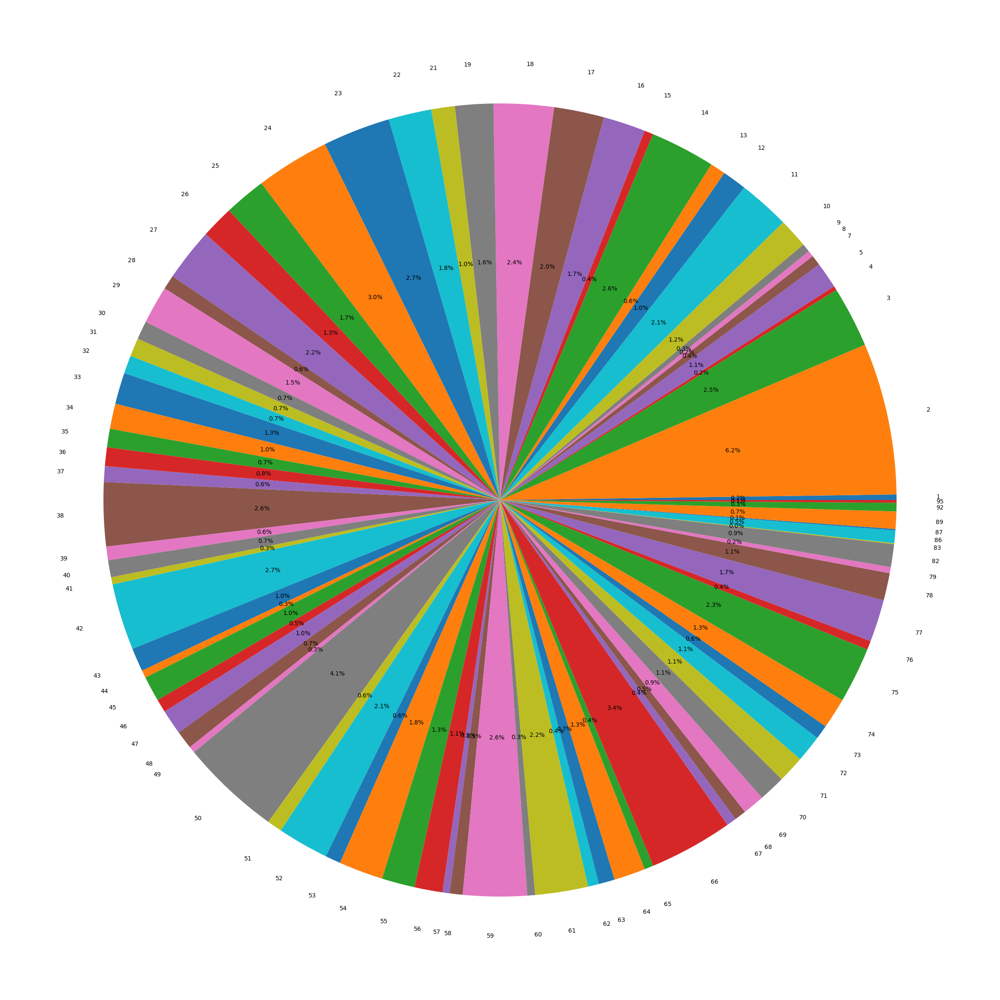

In [18]:
fig1, ax1 = plt.subplots(figsize = (30, 30))
ax1.pie(region_dist['id'], labels = region_dist['regions'], autopct = '%1.1f%%')
plt.show()

<BarContainer object of 2 artists>

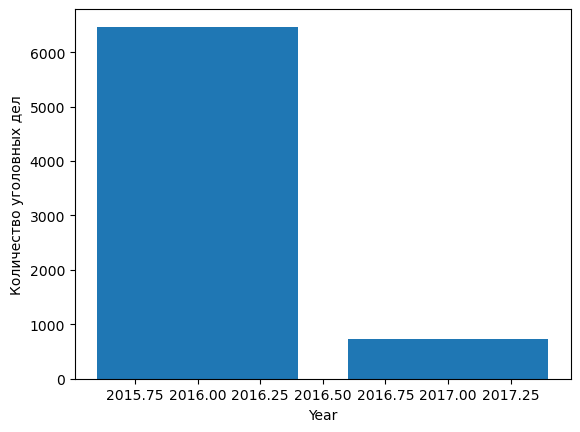

In [19]:
years = data_full['year'].value_counts()
plt.xlabel('Year')
plt.ylabel('Количество уголовных дел')
plt.bar(x=years.index, height=years.values)

In [20]:
url = 'https://raw.githubusercontent.com/codeforamerica/click_that_hood/master/public/data/russia.geojson'
with urlopen(url) as response:
    counties = json.load(response)

In [21]:
regions_map = pd.DataFrame()

In [22]:
regions_map['name'] = [counties['features'][i]['properties']['name']
              for i in range(len(counties['features']))]

In [23]:
regions_map['id'] = [counties['features'][i]['properties']['cartodb_id']
            for i in range(len(counties['features']))]

In [24]:
regions_map = regions_map.merge(region_dist, left_on='id', right_on='regions', suffixes=('_left', '_right'))

In [25]:
regions_map

,name,id_left,id_right,year,instance,court_name,caseNumber,entryDate,names,judge,...,knife,motivate,place_own,prokuror,advokate,year_per,hands,sex2,kilss,regions
0,Бурятия,10,87,87,87,87,87,87,87,87,...,87,87,87,87,87,87,87,87,87,10
1,Карачаево-Черкесская республика,13,45,45,45,45,45,45,45,45,...,45,45,45,45,45,45,45,45,45,13
2,Сахалинская область,11,151,151,151,151,151,151,151,151,...,151,151,151,151,151,151,151,151,151,11
3,Воронежская область,16,124,124,124,124,124,124,124,124,...,124,124,124,124,124,124,124,124,124,16
4,Томская область,18,176,176,176,176,176,176,176,176,...,176,176,176,176,176,176,176,176,176,18
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
74,Удмуртская республика,59,187,187,187,187,187,187,187,187,...,187,187,187,187,187,187,187,187,187,59
75,Вологодская область,55,97,97,97,97,97,97,97,97,...,97,97,97,97,97,97,97,97,97,55
76,Ингушетия,34,74,74,74,74,74,74,74,74,...,74,74,74,74,74,74,74,74,74,34
77,Челябинская область,24,216,216,216,216,216,216,216,216,...,216,216,216,216,216,216,216,216,216,24


In [26]:
fig = px.choropleth_mapbox(regions_map, geojson = counties, locations = 'id_left',
                           color='id_right',
                           featureidkey='properties.cartodb_id',
                           mapbox_style="carto-positron",
                          zoom=1.5,
                          center = {"lat":71, "lon":105},height = 800, width = 1000,
                           opacity = 0.5, hover_name = 'name', color_continuous_scale="Viridis", title='количество преступлений в регионах России')

In [27]:
data_bezrab = pd.read_csv('bezrabat.csv')

In [28]:
data_bezrab

,id_reg,region,num,naselenie
0,26,Белгородская область,4,"1550,1"
1,27,Брянская область,"5,1","1225,8"
2,22,Владимирская область,"6,3","1397,2"
3,16,Воронежская область,"4,5","2333,5"
4,57,Ивановская область,"5,2","1029,8"
...,...,...,...,...
78,81,Амурская область,6,"805,7"
79,7,Магаданская область,"4,4","146,4"
80,11,Сахалинская область,"6,6","487,3"
81,80,Еврейская автономная область,"7,3","166,1"


In [ ]:
for i in range(83):
    data_bezrab['num'][i] = data_bezrab['num'][i].replace(',', '.')

In [30]:
data_bezrab['num'] = data_bezrab['num'].astype(float)

In [31]:
regions_map = regions_map.merge(data_bezrab, left_on='id_left', right_on='id_reg', suffixes=('_left', '_right'))

In [32]:
fig2 = px.choropleth_mapbox(regions_map, geojson = counties, locations = 'id_left',
                           color='num',
                           featureidkey='properties.cartodb_id',
                           mapbox_style="carto-positron",
                          zoom=1.5,
                          center = {"lat":71, "lon":105},height = 800, width = 1000,
                           opacity = 0.5, hover_name = 'name', color_continuous_scale="Viridis", title='Индекс безработицы в регионах России')

In [33]:
regions_map['new_s'] = regions_map['id_right']


In [ ]:
for i in range(83):
    regions_map['naselenie'][i] = regions_map['naselenie'][i].replace(',', '.')

In [ ]:
for i in range(83):
    regions_map['naselenie'][i] = regions_map['naselenie'][i].replace(' ', '')

In [38]:
regions_map['naselenie'] = regions_map['naselenie'].astype(float)

In [ ]:
for i in range (79):
    regions_map['new_s'][i] = regions_map['new_s'][i] / regions_map['naselenie'][i] 

In [40]:
fig3 = px.choropleth_mapbox(regions_map, geojson = counties, locations = 'id_left',
                           color='new_s',
                           featureidkey='properties.cartodb_id',
                           mapbox_style="carto-positron",
                          zoom=1.5,
                          center = {"lat":71, "lon":105},height = 800, width = 1000,
                           opacity = 0.5, hover_name = 'name', color_continuous_scale="Viridis", title='Индекс количества убийств на количество жителей')

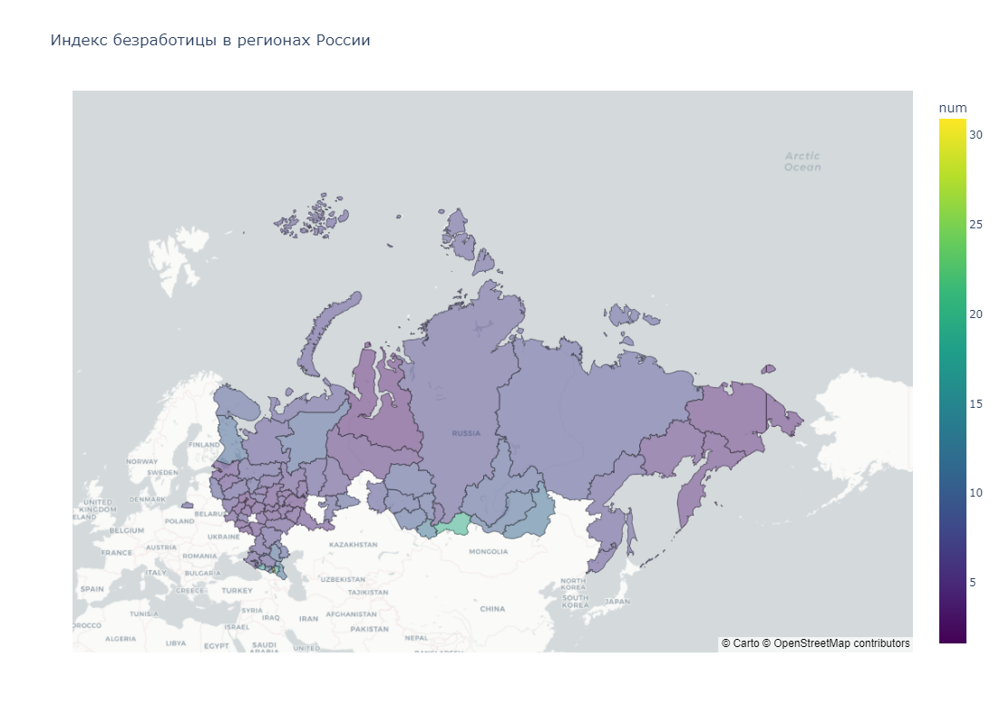

In [41]:
fig2.show()

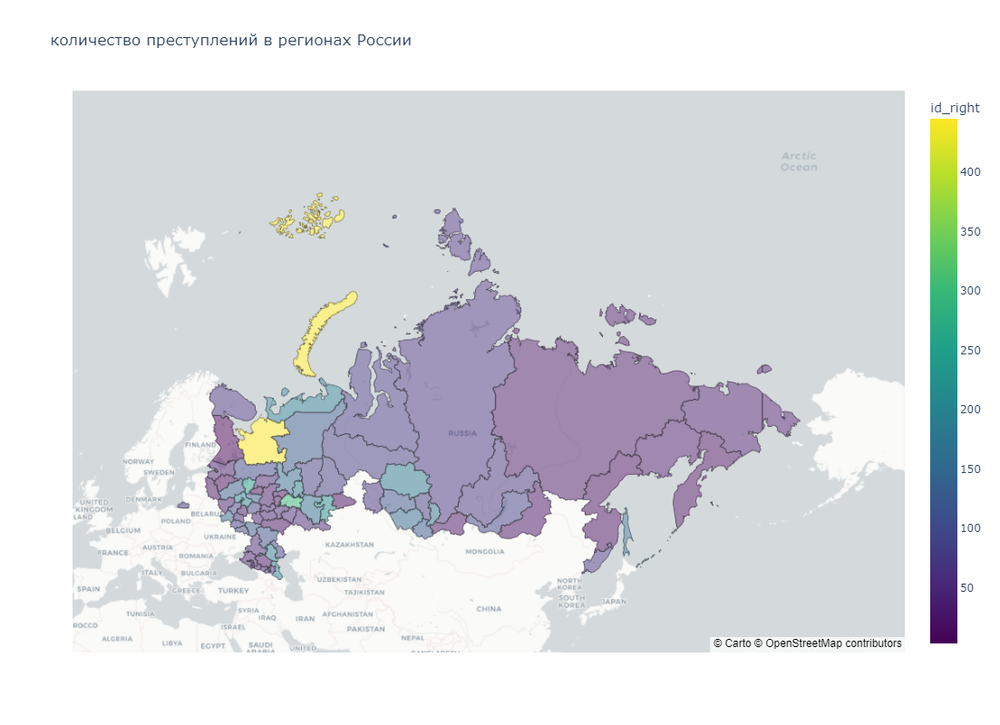

In [42]:
fig.show()

Далее идет очистка и форматирование данных

In [44]:
data_full['year'][30]

2016

In [45]:
data_2016 = data_full.loc[data_full['year'] == 2016]

In [46]:
len(data_2016)

6469

In [47]:
data_2016.columns

Index(['id', 'region', 'year', 'instance', 'court_name', 'caseNumber',
       'entryDate', 'names', 'judge', 'resultDate', 'decision', 'endDate',
       'consideredBy', 'cui', 'accused', 'hash', 'articles', 'link_meta',
       'link_text', 'is_text', 'text', 'sex', 'advocacy', 'repentance', 'fine',
       'ling', 'family', 'husb', 'place', 'alco', 'reg', 'time_sut', 'gun',
       'knife', 'motivate', 'place_own', 'prokuror', 'advokate', 'year_per',
       'hands', 'sex2', 'kilss'],
      dtype='object')

In [48]:
data_2016['year_per'].unique()

array(['лето', 'Лето', 'весна', 'осень', 'зима', '2016', '2015', 'Осень',
       'Весна', 'Зима', '2014', 'летне-осенний период', 'нет', '2012',
       '1997', 'лето-осень', 'неизвестно', '2010', 'не указано', '2001',
       '2013'], dtype=object)

In [ ]:
for i in range(len(data_2016)):
  if data_2016['year_per'][i] == 'Лето' or data_2016['year_per'][i] == 'лето' or data_2016['year_per'][i] == 'летне-осенний период' or data_2016['year_per'][i] == 'лето-осень':
    data_2016['year_per'][i] = 3
  elif data_2016['year_per'][i] == 'Зима' or data_2016['year_per'][i] == 'зима':
    data_2016['year_per'][i] = 1
  elif data_2016['year_per'][i] == 'Весна' or data_2016['year_per'][i] == 'весна':
    data_2016['year_per'][i] = 2
  elif data_2016['year_per'][i] == 'Осень' or data_2016['year_per'][i] == 'осень':
    data_2016['year_per'][i] = 4
  else:
    data_2016['year_per'][i] = 0

Зима 1, Весна 2, Лето 3, Осень 5, неизвестно 0

In [50]:
data_2016['year_per'].unique()

array([3, 2, 4, 1, 0], dtype=object)

In [ ]:
for i in range(len(data_2016)):
  if data_2016['alco'][i] == True:
    data_2016['alco'][i] = 1
  else:
    data_2016['alco'][i] = 0

In [52]:
data_2016['alco'].unique()

array([1, 0], dtype=object)

In [ ]:
for i in range(len(data_2016)):
  if data_2016['husb'][i] == True:
    data_2016['husb'][i] = 1
  else:
    data_2016['husb'][i] = 0

In [54]:
data_2016['husb'].unique()

array([0, 1], dtype=object)

In [ ]:
for i in range(len(data_2016)):
  if data_2016['place_own'][i] == True:
    data_2016['place_own'][i] = 1
  else:
    data_2016['place_own'][i] = 0

In [56]:
data_2016['place_own'].unique()

array([0, 1], dtype=object)

In [ ]:
for i in range(len(data_2016)):
  if data_2016['advocacy'][i] == True:
    data_2016['advocacy'][i] = 1
  else:
    data_2016['advocacy'][i] = 0

In [58]:
data_2016['advocacy'].unique()

array([1, 0], dtype=object)

In [ ]:
for i in range(len(data_2016)):
  if data_2016['hands'][i] == True:
    data_2016['hands'][i] = 1
  else:
    data_2016['hands'][i] = 0

In [60]:
data_2016['hands'].unique()

array([0, 1], dtype=object)

In [61]:
data_2016['place'].unique()

array(['свалка', 'частный дом',
       'хозяйственная постройка на территории молочно-товарной фермы',
       'дом', 'Магазин', 'река', 'общественное место', 'квартира',
       'лесном массиве', 'в квартире', 'на дороге', 'кухне', 'квартире',
       'на участке местности', 'лесной массив', 'кухня',
       'лестничная площадка 2 этажа', 'гаражно-строительный кооператив',
       'дорога возле дома', 'в общественном месте', 'жилой части дома',
       'в частном доме', 'летний дом', 'Дом', 'общежитие', 'котельная',
       'дача', 'шиносервис', 'территория металлобазы',
       'дворовая территория', 'гаражный бокс',
       'подвальное помещение дома', 'торговый зал гипермаркета', 'пруд',
       'заброшенная военная ракетная шахта', 'Дом одиноких престарелых',
       'на открытом воздухе', 'реабилитационный центр',
       'полуострове Фаддеевский Котельный архипелаге Новосибирских островов',
       'озеро', 'территория свалки', 'палатка', 'строящийся дом',
       'дороге', 'подъезде дома', '

In [62]:
data_2016['motivate'].unique()

array(['Личная ссора', 'конфликт', 'личная ссора', 'Конфликт',
       'убийство лиц', 'разбой, убийство', 'разбой', 'ревность',
       'личная неприязнь',
       'разбойное нападение, хищение имущества, убийство',
       'личная неприязнь, ревность', 'хулиганские побуждения',
       'Семейный конфликт',
       'личная неприязнь, разногласия по поводу прохождения военной службы и участия в боевых действиях',
       'конфликт из-за собаки', 'Хищение имущества, убийство',
       'Избавление от боли', 'оскорбление',
       'личная неприязнь, отказ в деньгах', 'квартирный вопрос',
       'личные неприязненные отношения',
       'личная неприязнь, алкогольное опьянение',
       'Мошенничество, хищение, умышленное причинение смерти, организация убийства',
       'неизвестно', 'Ревность', 'Развод', 'Бытовая ссора',
       'кража материальных ценностей', 'лишение жизни',
       'Отказ вступить в половую связь',
       'предполагаемый мотив - неприязнь из-за сексуальной ориентации',
       'разб

In [63]:
data_2016['time_sut'].unique()

array(['дневное время', 'Утро', 'вечер', 'дневное', 'Ночь', 'ночь',
       'утро', 'вечернее', 'днем', 'день', 'Вечер', 'Дневное',
       'ночное время', 'ночное', 'утреннее', 'вечернее время',
       'Дневное время', 'Днем', 'послеобеденное', 'вечернее-ночное',
       'Вечернее время', 'вечернее сутки', 'утро, день', 'Ночное время',
       'утреннее время суток', 'нет', 'дневное суток', 'утреннее суток',
       'утренние часы', 'половина дня', 'утреннее время',
       'темное время суток', 'первая половина дня', 'вечером',
       'дневно-вечернее', 'Утро, Вечер', 'дневной', 'вечер/ночь',
       'середина сентября', 'в течение дня', 'в темное время суток',
       'вечернее-ночное время'], dtype=object)

In [ ]:
for i in range(len(data_2016)):
    if data_2016['time_sut'][i] in ['Утро','утро','утреннее суток','утренние часы','утреннее','утро, день','утреннее время суток', 'утреннее время']:
        data_2016['time_sut'][i] = 1
    elif data_2016['time_sut'][i] in ['дневное суток','дневное время','дневное', 'днем', 'день', 'Дневное', 'Дневное время', 'Днем', 'послеобеденное', 'половина дня', 'первая половина дня', 'дневной', 'середина сентября', 'в течение дня']:
        data_2016['time_sut'][i] = 2
    elif data_2016['time_sut'][i] in ['вечер', 'вечернее', 'Вечер', 'вечернее время', 'Вечернее время', 'вечернее сутки', 'темное время суток', 'вечером', 'дневно-вечернее', 'Утро, Вечер']:
        data_2016['time_sut'][i] = 3
    elif data_2016['time_sut'][i] in ['Ночь', 'ночь', 'ночное время', 'ночное', 'вечернее-ночное', 'Ночное время', 'вечер/ночь', 'в темное время суток', 'вечернее-ночное время', 'нет']:
        data_2016['time_sut'][i] = 4

In [65]:
data_2016['time_sut'].unique()

array([2, 1, 3, 4, 'нет', 'дневное суток', 'утреннее время',
       'середина сентября', 'в течение дня'], dtype=object)

In [66]:
data_2016['time_sut']

0       2
1       1
2       2
3       3
4       2
       ..
6464    3
6465    2
6466    3
6467    3
6468    3
Name: time_sut, Length: 6469, dtype: object

In [67]:
j = 0
for j in range(len(data_2016)):
    if type(data_2016['repentance'][j]) == dict:
        print(j)

2278


In [ ]:
data_2016['repentance'][2278] = 'Частично' 

In [73]:
j = 0
for j in range(len(data_2016)):
    if type(data_2016['sex'][j]) == dict:
        print(j)

In [76]:
data_2016['sex'].unique()

array([1, 0], dtype=object)

In [ ]:
for i in range(len(data_2016)):
  if data_2016['sex'][i] == 'мужской':
    data_2016['sex'][i] = 1
  else:
    data_2016['sex'][i] = 0

In [79]:
j = 0
for j in range(len(data_2016)):
    if type(data_2016['sex2'][j]) == list:
        print(j)

302
557
4191
5226


In [ ]:
data_2016['sex2'][302] = data_2016['sex2'][302][0]
data_2016['sex2'][557] = data_2016['sex2'][557][0]
data_2016['sex2'][4191] = data_2016['sex2'][4191][0]
data_2016['sex2'][5226] = data_2016['sex2'][5226][0]

In [81]:
data_2016['sex2'].unique()

array(['женский', 'мужской', 'неизвестно', 'Мужской', 'Женский', 'нет',
       'оба', 'Неизвестно'], dtype=object)

In [ ]:
for i in range(len(data_2016)):
  if data_2016['sex2'][i] == 'Мужской' or data_2016['sex2'][i] == 'мужской' :
    data_2016['sex2'][i] = 1
  elif data_2016['sex2'][i] == 'Женский' or data_2016['sex2'][i] == 'женский':
    data_2016['sex2'][i] = 0
  elif data_2016['sex2'][i] == 'оба':
    data_2016['sex2'][i] = 2
  elif data_2016['sex2'][i] == 'нет' or data_2016['sex2'][i] == 'неизвестно' or data_2016['sex2'][i] == 'Неизвестно':
    data_2016['sex2'][i] = 3

In [83]:
data_2016['sex2'].unique()

array([0, 1, 3, 2], dtype=object)

0 - Женский, 1 - Мужской, 2 - Оба пола(2 жертвы), 3 - неизвестно

In [84]:
data_2016['repentance'].unique()

array(['Признал', 'Признала', 'Неизвестно', 'Частично признал',
       'Не признал', 'Признал, раскаялся', 'частично признал',
       'Раскаялась', 'нет', 'Признала, Раскаялась', 'частично',
       'Частично', 'Раскаялся', 'Признал, Не признал, Неизвестно',
       'Призналась'], dtype=object)

In [ ]:
for i in range(len(data_2016)):
  if data_2016['repentance'][i] == 'Признал' or data_2016['repentance'][i] == 'Признала' or data_2016['repentance'][i] == 'Призналась':
    data_2016['repentance'][i] = 1
  elif data_2016['repentance'][i] == 'Частично признал' or data_2016['repentance'][i] == 'частично признал' or data_2016['repentance'][i] == 'Частично' or data_2016['repentance'][i] == 'частично' :
    data_2016['repentance'][i] = 2
  elif data_2016['repentance'][i] == 'Признал, раскаялся' or data_2016['repentance'][i] == 'Признала, Раскаялась' or data_2016['repentance'][i] == 'Раскаялся' or data_2016['repentance'][i] == 'Раскаялась':
    data_2016['repentance'][i] = 3
  elif data_2016['repentance'][i] == 'Не признал':
      data_2016['repentance'][i] = 4
  elif data_2016['repentance'][i] == 'Признал, Не признал, Неизвестно' or data_2016['repentance'][i] == 'Неизвестно' or data_2016['repentance'][i] == 'нет':
    data_2016['repentance'][i] = 0

0 - неизвестно, 1 - признал, 2 - частично признал, 3 - раскаялся, 4 -  не признал

In [86]:
data_2016['repentance'].unique()

array([1, 0, 2, 4, 3], dtype=object)

In [ ]:
for i in range(len(data_2016)):
  if data_2016['gun'][i] == True:
    data_2016['gun'][i] = 1
  else:
    data_2016['gun'][i] = 0


In [88]:
data_2016['gun'].unique()

array([0, 1], dtype=object)

In [ ]:
for i in range(len(data_2016)):
  if data_2016['knife'][i] == True:
    data_2016['knife'][i] = 1
  else:
    data_2016['knife'][i] = 0

In [90]:
data_2016['knife'].unique()

array([0, 1], dtype=object)

In [91]:
data_2016['time_sut'].describe()

count     6469
unique       9
top          3
freq      2488
Name: time_sut, dtype: int64

In [113]:
data_2016['family'].unique()

array([False, True, 'нет'], dtype=object)

In [114]:
for i in range(len(data_2016)):
  if data_2016['family'][i] == True:
    data_2016['family'][i] = 1
  else:
    data_2016['family'][i] = 0

In [93]:
data_2016.columns

Index(['id', 'region', 'year', 'instance', 'court_name', 'caseNumber',
       'entryDate', 'names', 'judge', 'resultDate', 'decision', 'endDate',
       'consideredBy', 'cui', 'accused', 'hash', 'articles', 'link_meta',
       'link_text', 'is_text', 'text', 'sex', 'advocacy', 'repentance', 'fine',
       'ling', 'family', 'husb', 'place', 'alco', 'reg', 'time_sut', 'gun',
       'knife', 'motivate', 'place_own', 'prokuror', 'advokate', 'year_per',
       'hands', 'sex2', 'kilss'],
      dtype='object')

In [141]:
data_newest = data_2016[['region','sex', 'sex2', 'alco', 'gun', 'hands', 'knife', 'year_per', 'time_sut', 'husb', 'family']]

In [142]:
data_newest['family'].unique()

array([0, 1], dtype=object)

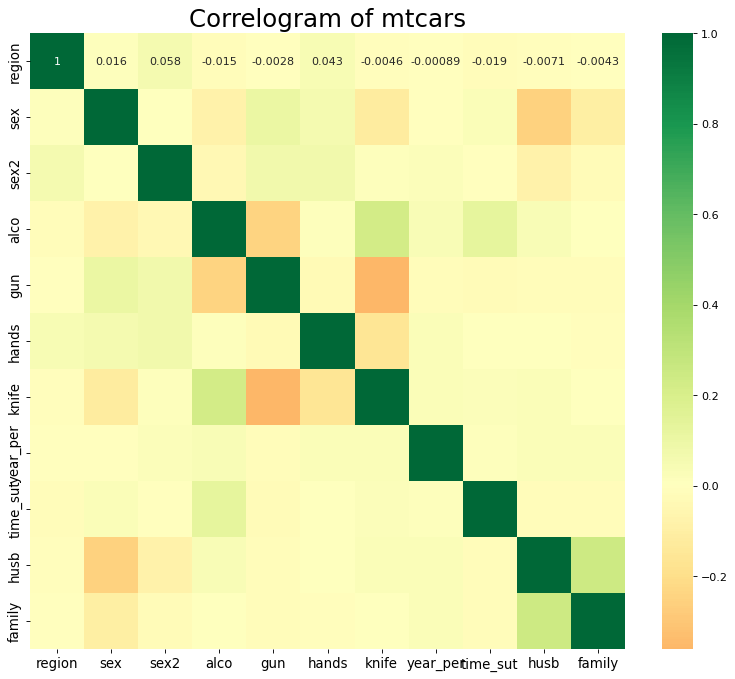

In [143]:
plt.figure(figsize=(12,10), dpi= 80)
sns.heatmap(data_newest.corr(), xticklabels=data_newest.corr().columns, yticklabels=data_newest.corr().columns, cmap='RdYlGn', center=0, annot=True)

# Decorations
plt.title('Correlogram of mtcars', fontsize=22)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.show()

Нахождение частот для пола преступника/жертвы и других характеристик

In [144]:
tab = pd.crosstab(index=data_newest['sex'], columns='count')
tab/tab.sum()

col_0,count
sex,
0,0.161694
1,0.838306


In [152]:
tab = pd.crosstab(index=data_newest['sex2'], columns='count')
tab/tab.sum()

col_0,count
sex2,
0,0.188128
1,0.643840
2,0.165095
3,0.002937


In [145]:
tab = pd.crosstab(index=data_newest['alco'], columns='count')
tab/tab.sum()

col_0,count
alco,
0,0.129695
1,0.870305


In [153]:
tab = pd.crosstab(index=data_newest['hands'], columns='count')
tab/tab.sum()

col_0,count
hands,
0,0.957799
1,0.042201


In [146]:
tab = pd.crosstab(index=data_newest['gun'], columns='count')
tab/tab.sum()

col_0,count
gun,
0,0.931674
1,0.068326


In [147]:
tab = pd.crosstab(index=data_newest['knife'], columns='count')
tab/tab.sum()

col_0,count
knife,
0,0.269284
1,0.730716


In [148]:
tab = pd.crosstab(index=data_newest['time_sut'], columns='count')
tab/tab.sum()

col_0,count
time_sut,
1,0.045911
2,0.234348
3,0.384603
4,0.335137


In [149]:
tab = pd.crosstab(index=data_newest['year_per'], columns='count')
tab/tab.sum()

col_0,count
year_per,
0,0.051785
1,0.243623
2,0.202813
3,0.358943
4,0.142835


In [150]:
tab = pd.crosstab(index=data_newest['husb'], columns='count')
tab/tab.sum()

col_0,count
husb,
0,0.951306
1,0.048694


In [151]:
tab = pd.crosstab(index=data_newest['family'], columns='count')
tab/tab.sum()

col_0,count
family,
0,0.988561
1,0.011439


Нахождение частот ля преступлений, где среди жерт есть девушка

In [169]:
data_newest_fem_vict = data_newest.loc[(data_newest['sex2'] == 0) | (data_newest['sex2'] == 2)]

In [158]:
tab = pd.crosstab(index=data_newest_fem_vict['sex'], columns='count')
tab/tab.sum()

col_0,count
sex,
0,0.058643
1,0.941357


In [159]:
tab = pd.crosstab(index=data_newest_fem_vict['sex2'], columns='count')
tab/tab.sum()

col_0,count
sex2,
0,0.532604
2,0.467396


In [160]:
tab = pd.crosstab(index=data_newest_fem_vict['alco'], columns='count')
tab/tab.sum()

col_0,count
alco,
0,0.165864
1,0.834136


In [161]:
tab = pd.crosstab(index=data_newest_fem_vict['knife'], columns='count')
tab/tab.sum()

col_0,count
knife,
0,0.34442
1,0.65558


In [162]:
tab = pd.crosstab(index=data_newest_fem_vict['gun'], columns='count')
tab/tab.sum()

col_0,count
gun,
0,0.936543
1,0.063457


In [163]:
tab = pd.crosstab(index=data_newest_fem_vict['husb'], columns='count')
tab/tab.sum()

col_0,count
husb,
0,0.948359
1,0.051641


In [164]:
tab = pd.crosstab(index=data_newest_fem_vict['family'], columns='count')
tab/tab.sum()

col_0,count
family,
0,0.989059
1,0.010941


In [165]:
tab = pd.crosstab(index=data_newest_fem_vict['time_sut'], columns='count')
tab/tab.sum()

col_0,count
time_sut,
1,0.056893
2,0.239825
3,0.356674
4,0.346608


In [166]:
tab = pd.crosstab(index=data_newest_fem_vict['year_per'], columns='count')
tab/tab.sum()

col_0,count
year_per,
0,0.041575
1,0.241575
2,0.203501
3,0.370241
4,0.143107


Нахождение частот характеристик когда преступник женщина

In [168]:
data_newest_prest_vict = data_newest.loc[(data_newest['sex'] == 0)]

In [170]:
tab = pd.crosstab(index=data_newest_prest_vict['sex'], columns='count')
tab/tab.sum()

col_0,count
sex,
0,1.0


In [171]:
tab = pd.crosstab(index=data_newest_prest_vict['sex2'], columns='count')
tab/tab.sum()

col_0,count
sex2,
0,0.086042
1,0.866157
2,0.042065
3,0.005736


In [172]:
tab = pd.crosstab(index=data_newest_prest_vict['alco'], columns='count')
tab/tab.sum()

col_0,count
alco,
0,0.067878
1,0.932122


In [173]:
tab = pd.crosstab(index=data_newest_prest_vict['knife'], columns='count')
tab/tab.sum()

col_0,count
knife,
0,0.152008
1,0.847992


In [174]:
tab = pd.crosstab(index=data_newest_prest_vict['gun'], columns='count')
tab/tab.sum()

col_0,count
gun,
0,0.992352
1,0.007648


In [175]:
tab = pd.crosstab(index=data_newest_prest_vict['hands'], columns='count')
tab/tab.sum()

col_0,count
hands,
0,0.983748
1,0.016252


In [176]:
tab = pd.crosstab(index=data_newest_prest_vict['husb'], columns='count')
tab/tab.sum()

col_0,count
husb,
0,0.82696
1,0.17304


In [177]:
tab = pd.crosstab(index=data_newest_prest_vict['family'], columns='count')
tab/tab.sum()

col_0,count
family,
0,0.963671
1,0.036329


In [178]:
tab = pd.crosstab(index=data_newest_prest_vict['time_sut'], columns='count')
tab/tab.sum()

col_0,count
time_sut,
1,0.047801
2,0.258126
3,0.387189
4,0.306883


Рассчет частотных коэффициентов для преступлений, когда мужчина преступник и жертва также мужчина

In [182]:
data_newest_man = data_newest.loc[(data_newest['sex'] == 1) & (data_newest['sex2'] == 1)]

In [183]:
tab = pd.crosstab(index=data_newest_man['sex'], columns='count')
tab/tab.sum()

col_0,count
sex,
1,1.0


In [184]:
tab = pd.crosstab(index=data_newest_man['sex2'], columns='count')
tab/tab.sum()

col_0,count
sex2,
1,1.0


In [185]:
tab = pd.crosstab(index=data_newest_man['alco'], columns='count')
tab/tab.sum()

col_0,count
alco,
0,0.125192
1,0.874808


In [186]:
tab = pd.crosstab(index=data_newest_man['gun'], columns='count')
tab/tab.sum()

col_0,count
gun,
0,0.911322
1,0.088678


In [187]:
tab = pd.crosstab(index=data_newest_man['knife'], columns='count')
tab/tab.sum()

col_0,count
knife,
0,0.258055
1,0.741945


In [188]:
tab = pd.crosstab(index=data_newest_man['hands'], columns='count')
tab/tab.sum()

col_0,count
hands,
0,0.969929
1,0.030071


In [189]:
tab = pd.crosstab(index=data_newest_man['husb'], columns='count')
tab/tab.sum()

col_0,count
husb,
0,0.993863
1,0.006137


In [190]:
tab = pd.crosstab(index=data_newest_man['family'], columns='count')
tab/tab.sum()

col_0,count
family,
0,0.996011
1,0.003989


In [191]:
tab = pd.crosstab(index=data_newest_man['time_sut'], columns='count')
tab/tab.sum()

col_0,count
time_sut,
1,0.038355
2,0.222768
3,0.401657
4,0.337220


In [193]:
data_2016.to_pickle('data_2016.pickle')